In [1]:
# imports from custom library
import sys
sys.path.append('../../')
import matplotlib.pyplot as plt
from mlrefined_libraries import superlearn_library as superlearn
from mlrefined_libraries import calculus_library as callib
from mlrefined_libraries import math_optimization_library as optlib
import autograd.numpy as np
import math
import pandas as pd
from mlrefined_libraries import calculus_library as calclib

# import autograd
import autograd.numpy as np
import matplotlib.pyplot as plt

%matplotlib notebook

# this is needed to compensate for %matplotlib notebook's tendancy to blow up images when plotted inline
from matplotlib import rcParams
rcParams['figure.autolayout'] = True

%load_ext autoreload
%autoreload 2

#  Part 2: Derivatives at a point and the Numerical Differentiator

Press the botton 'Toggle code' below to toggle code on and off for entire this presentation.

In [2]:
from IPython.display import display
from IPython.display import HTML
import IPython.core.display as di # Example: di.display_html('<h3>%s:</h3>' % str, raw=True)

# This line will hide code by default when the notebook is exported as HTML
di.display_html('<script>jQuery(function() {if (jQuery("body.notebook_app").length == 0) { jQuery(".input_area").toggle(); jQuery(".prompt").toggle();}});</script>', raw=True)

# This line will add a button to toggle visibility of code blocks, for use with the HTML export version
di.display_html('''<button onclick="jQuery('.input_area').toggle(); jQuery('.prompt').toggle();">Toggle code</button>''', raw=True)

Toggle code

# 1. How do we define the derivative driven tangent line?

Remember what we said in words / pictures previously about the derivative of a function at a point: the derivative at a point defines a line that is always tangent to a function, encodes its steepness at that point, and generally matches the underlying function near the point locally.  In other words: the derivative at a point is the slope of the tangent line there.

> The derivative at a point is the slope of the tangent line at that point.

How can we more formally describe such a tangent line and derivative? 

# 1.1 Secant lines

<p><img src= '../../mlrefined_images/calculus_images/tangent_secant.png' width="100%" height="100%"/></p>

- (left panel) simple sinusoid with <span style="color:#32cd32"> the point $(w_0,g(w_0)) = (0, \text{sin}(0))$ colored green</span>

- (middle panel) <span style="color:blue">  another point $(w_1,g(w_1)) = (-2.6, \text{sin}(-2.6))$ shown in blue </span> and <span style="color:red"> the *secant line* connecting two points in red </span>

-  (right panel) <span style="color:#32cd32"> the tangent line at $w_0 = 0$ in green </span> 

<p><img src= '../../mlrefined_images/calculus_images/tangent_secant.png' width="100%" height="100%"/></p>


- A *secant line* is just a line formed by taking any two points on a function - like our sinusoid - and connecting them with a straight line. 

- A tangent line can cross through several points of a function it is explicitly defined using only a single point.  

- So in short - a secant line is defined by two points, a tangent line by just one.

### The equation of a secant line

- all we need is the slope and any point on the line to define it

- the slope of a line can be found using any two points on it (like the two points we used to define the secant to begin with)

The slope - the line's 'steepness' or 'rise over run' - is the ratio of change in output $g(w)$ over the change in input $w$.  For two points $w_0$ and $w_1$ it is

\begin{equation}
\text{slope of a secant line} = \frac{g(w^1) - g(w^0)}{w^1 - w^0}
\end{equation}

- equation of secant line

\begin{equation}
h(w)  = g(w^0) +  \frac{g(w^1) - g(w^0)}{w^1 - w^0}(w - w^0)
\end{equation}

#### <span style="color:#a50e3e;">Example 1. </span> Secant line computation

<p><img src= '../../mlrefined_images/calculus_images/tangent_secant.png' width="100%" height="100%"/></p>


With $w^0 = 0$ and $w^1 = -2.6$

\begin{equation}
h(w)  = \text{sin}(0) +  \frac{\text{sin}(-2.6) - \text{sin}(0)}{-2.6 - 0}(w - 0)
\end{equation}

- approximately the line

\begin{equation}
h(w)  =  \frac{0.5155}{2.6}w
\end{equation}

## 1.2 From secant to tangent line

- the tangent line at $w_0$ formed by secant line passing through $\left(w_0,g\left(w_0\right)\right)$ and $\left(w_1,g\left(w_1\right)\right)$,
and pushing $w_1$ towards $w_0$ from both left and right until $w_1 \approx w_0$

- the next slider widget illustrates precisely this idea


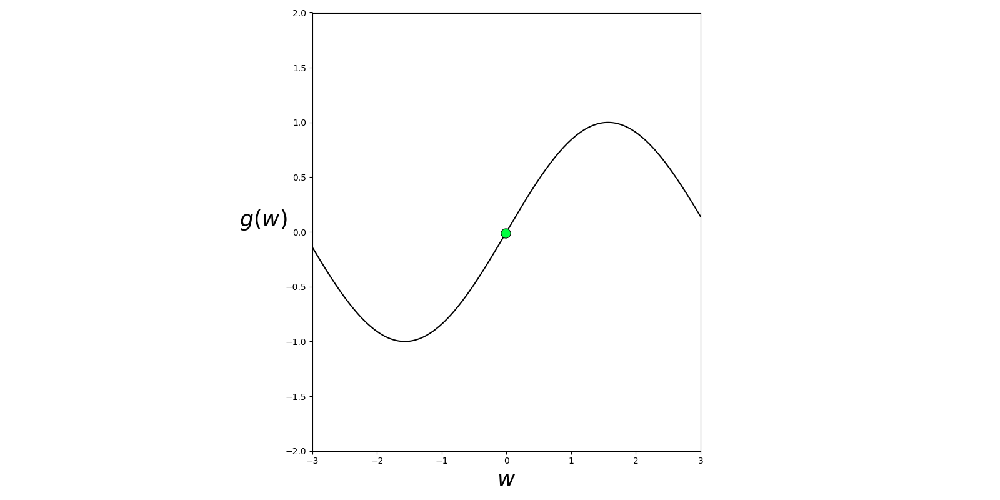
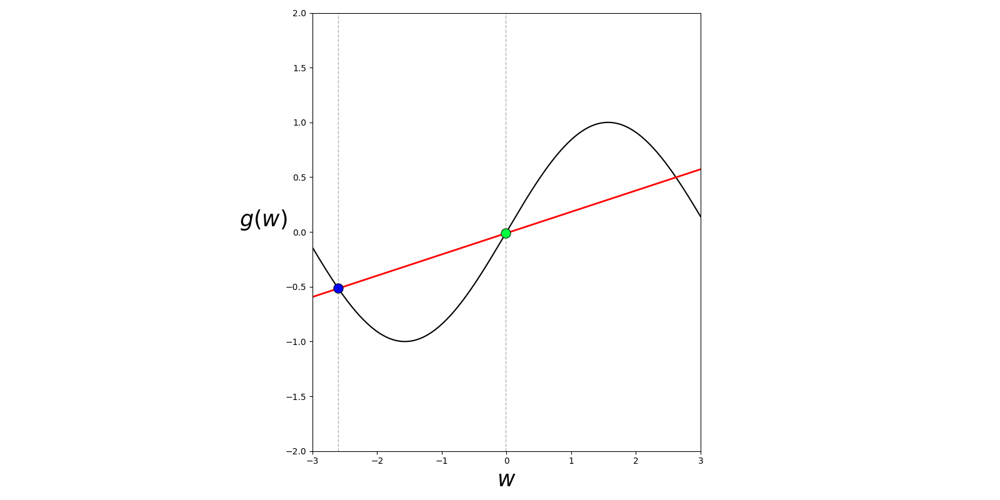
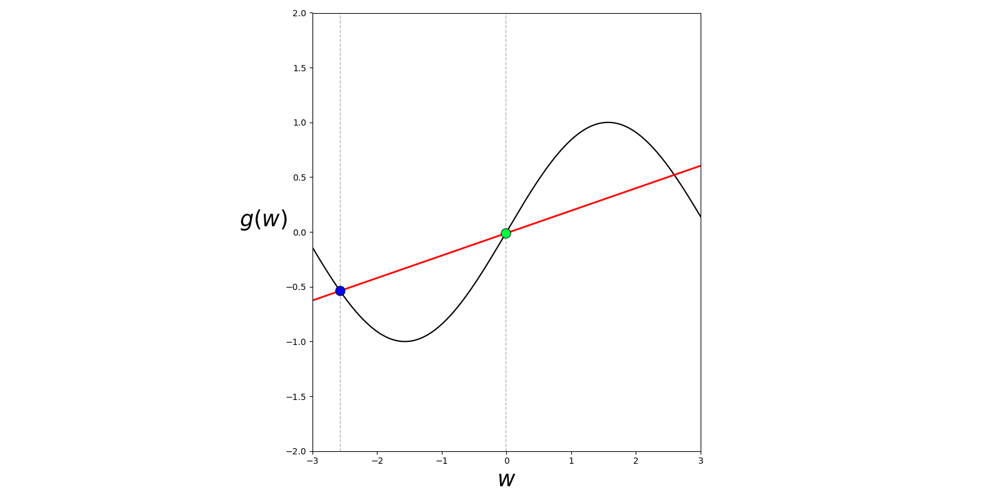
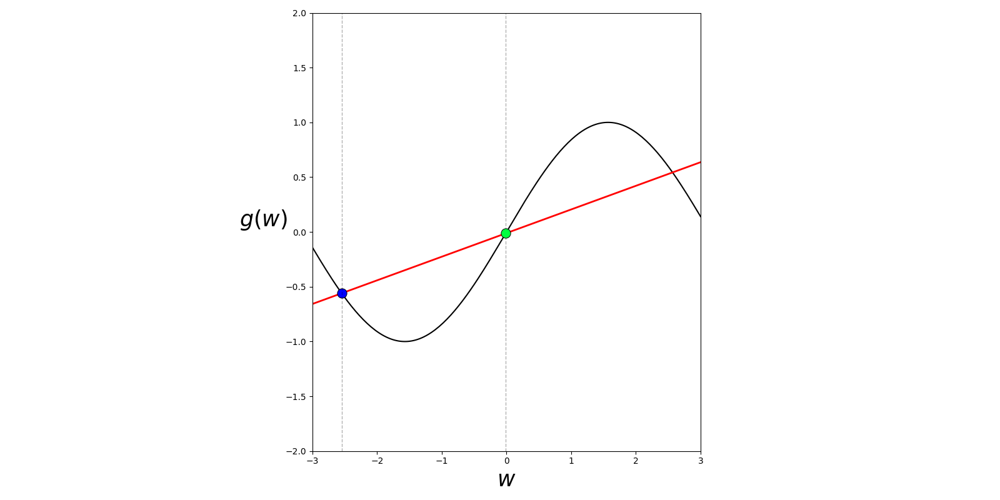
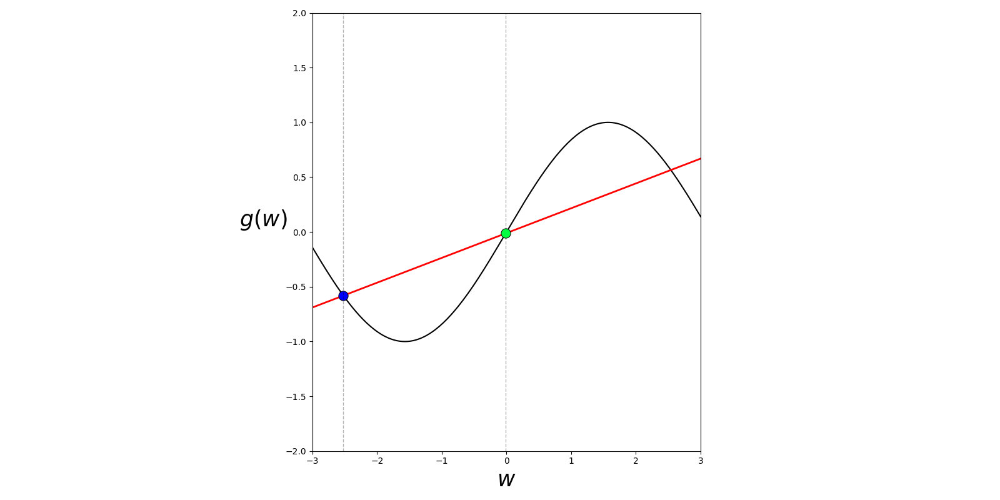
...
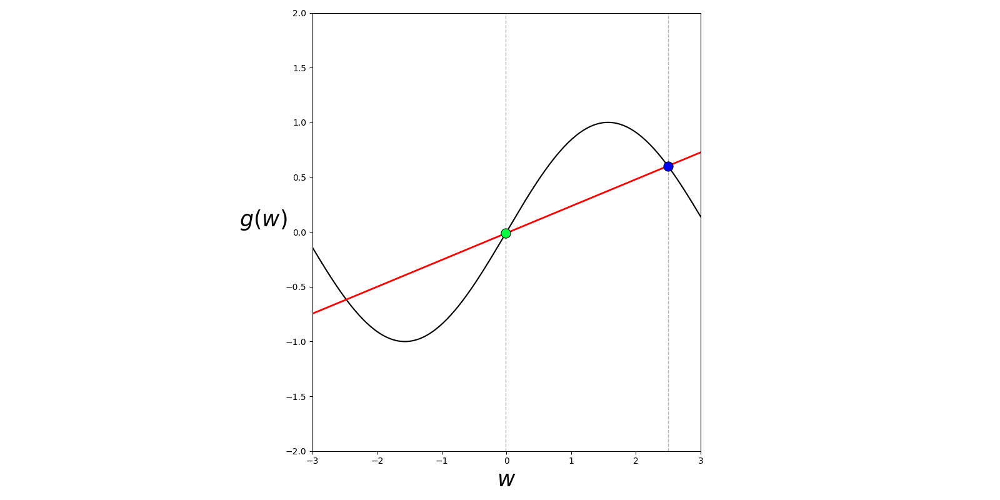
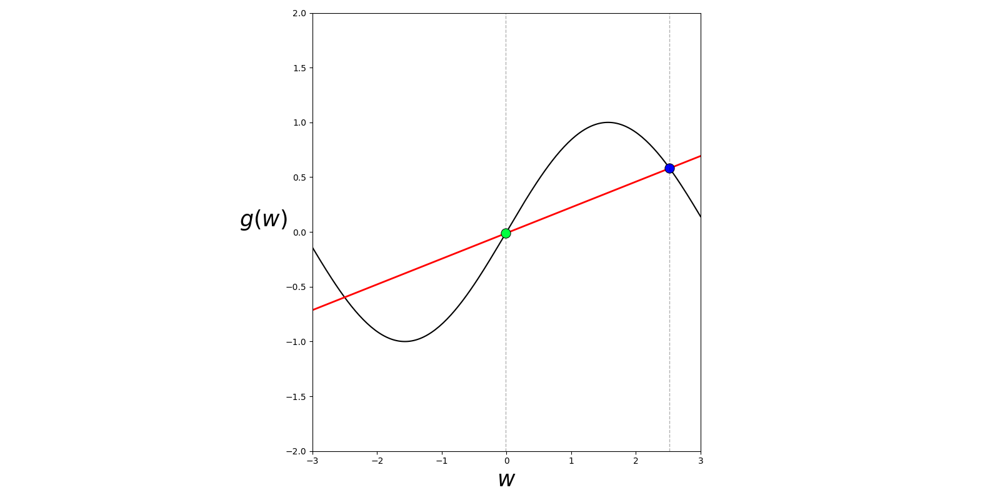
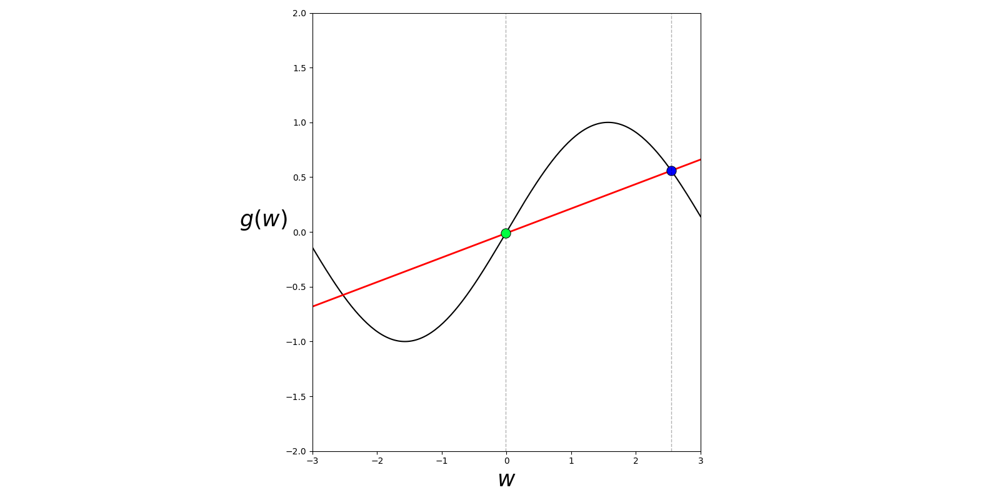
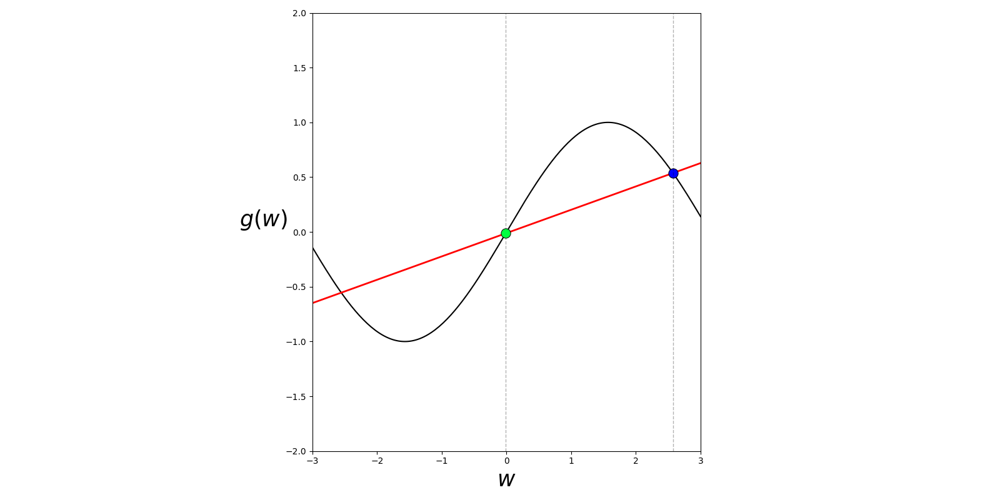
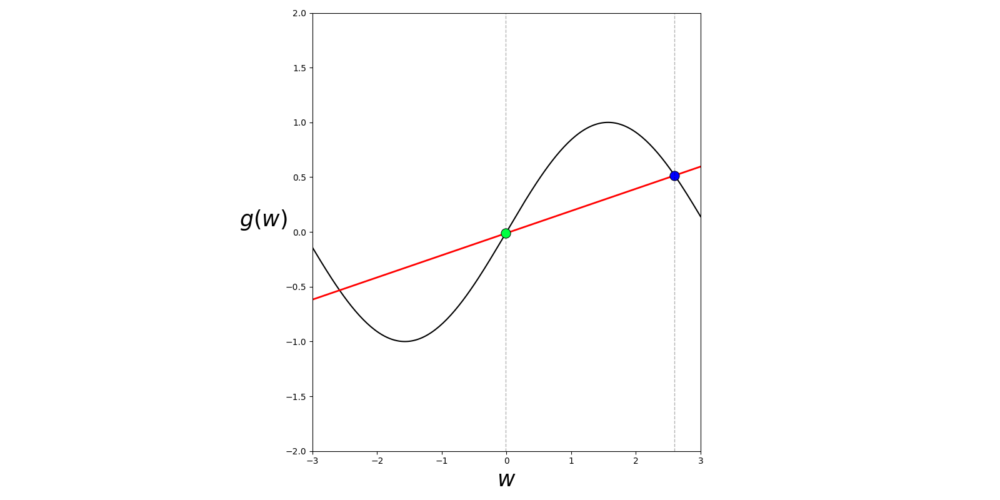

In [3]:
# what function should we play with?  Defined in the next line, along with our fixed point where we show tangency.
g = lambda w: np.sin(w)

# create an instance of the visualizer with this function
st = calclib.secant_to_tangent.visualizer(g = g)

# run the visualizer for our chosen input function and initial point
st.draw_it(w_init = 0, num_frames = 200)

> If the slope of the secant line varies gradually - with no visible jumps - from both the left and right of a fixed point on a function, we say that a function has a *derivative* at this point, or likewise say that it is *differentiable* at the point.  A function that has a derivative at every point is called differentiable.

#### <span style="color:#a50e3e;">Example 3. </span> An  example of failure: the rectified linear unit

- Notice: that the slope of the secant line must smoothly change to the slope of the tangent line from **both** directions - from both the left and right - is important to this definition. 

There are plenty of functions where this does not occur at every point, like the function

\begin{equation}
g(w) =  \text{max}(0,w)
\end{equation}

at the point $w^0 = 0$.  


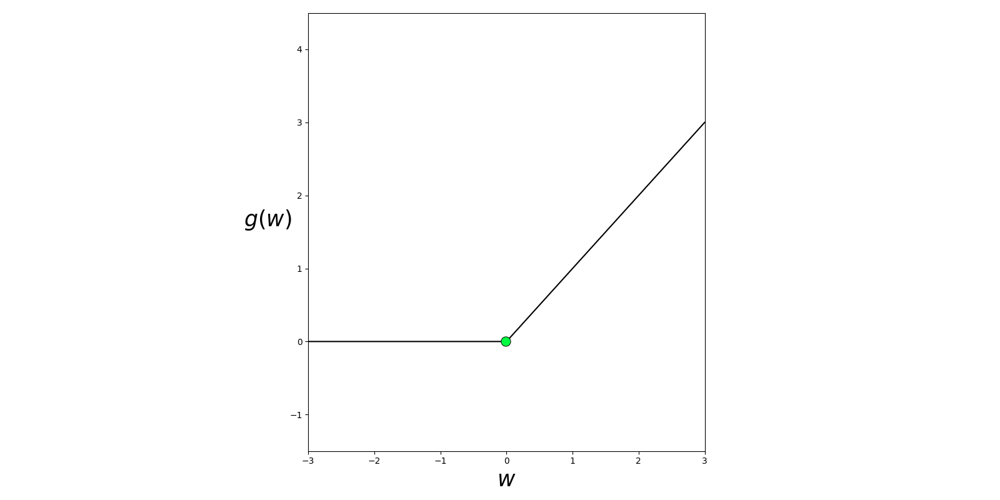
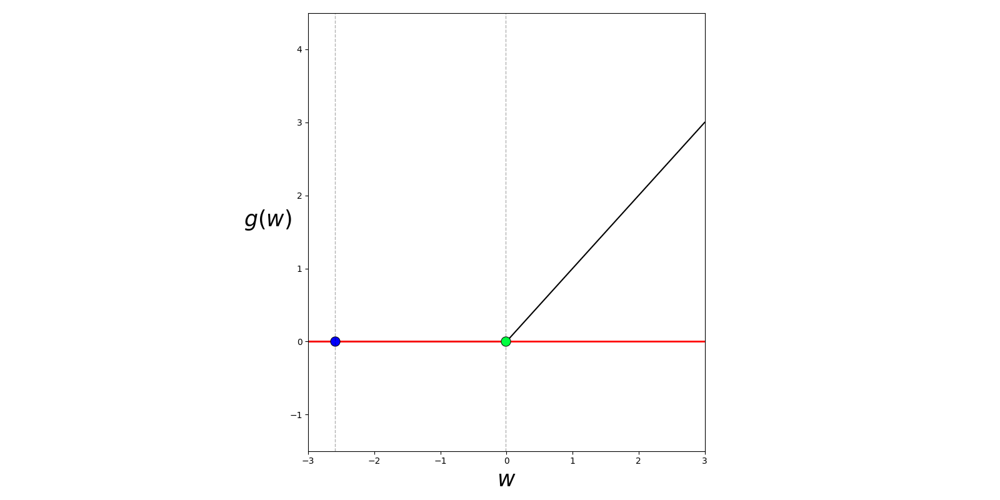
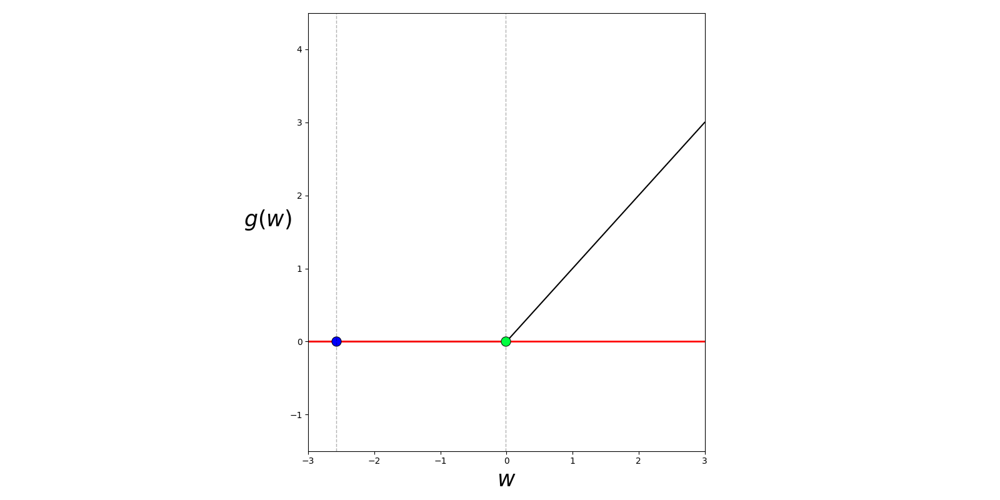
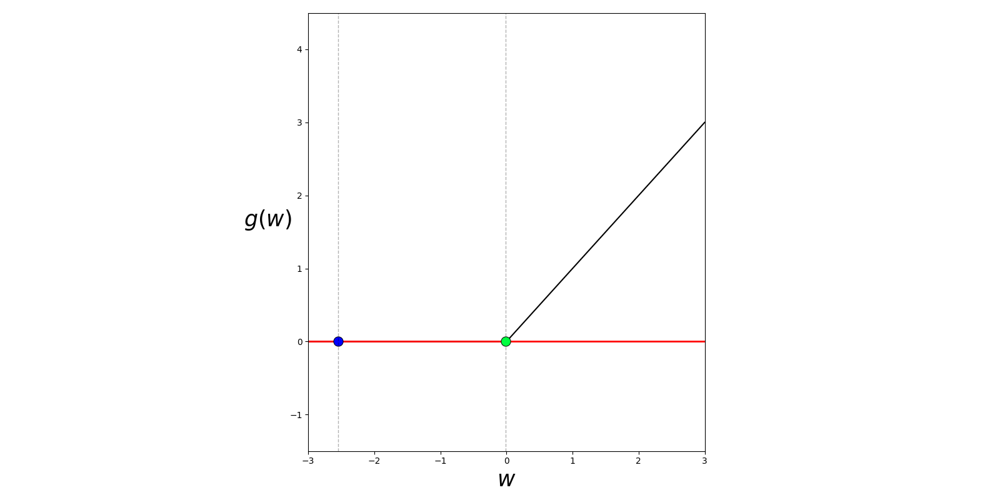
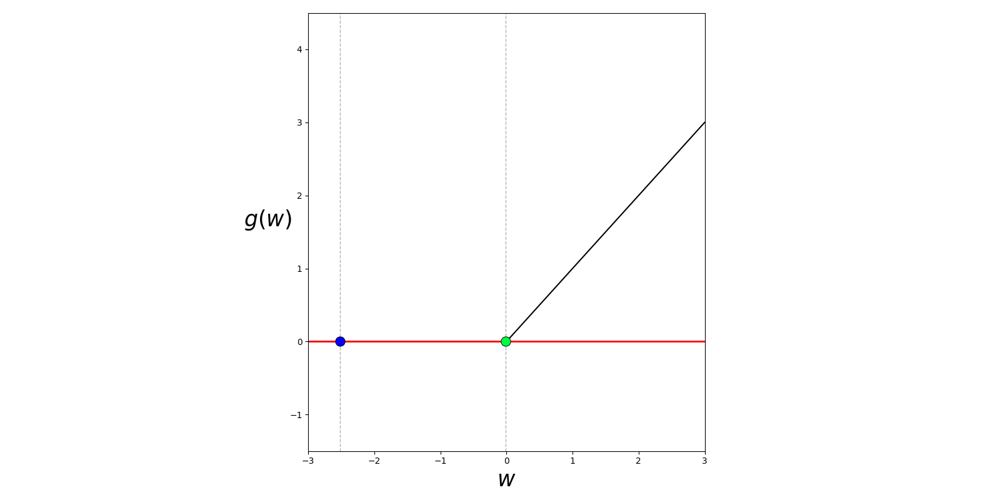
...
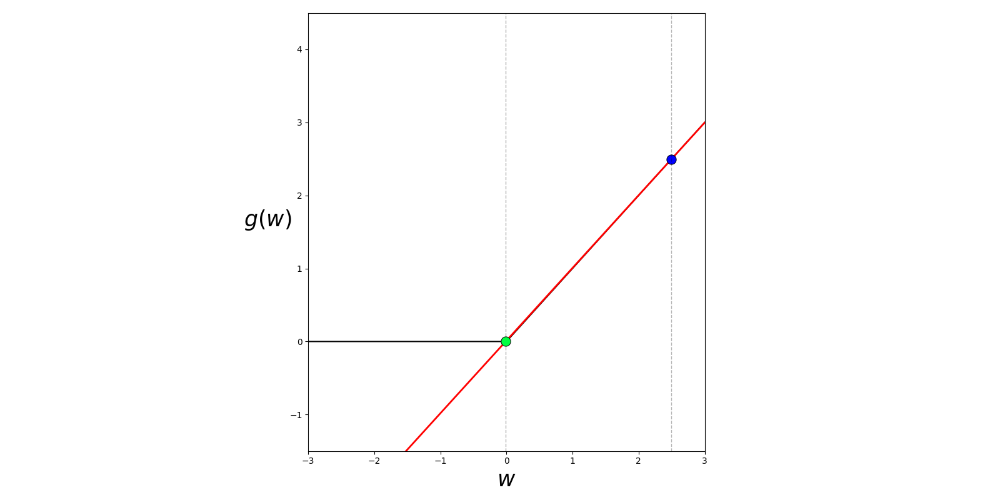
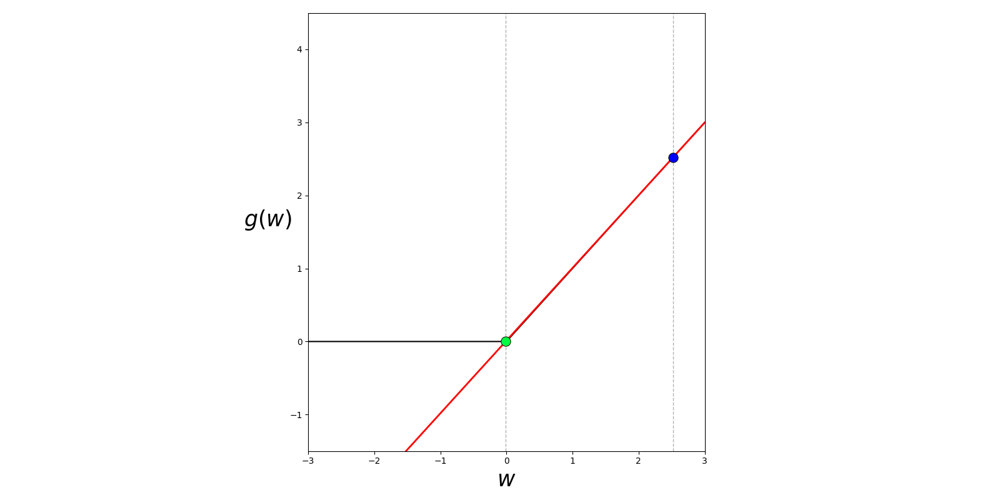
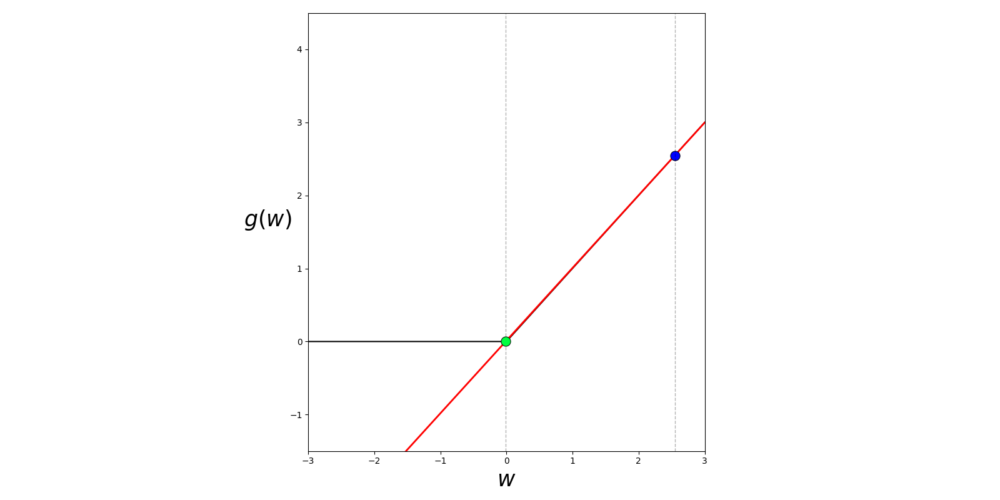
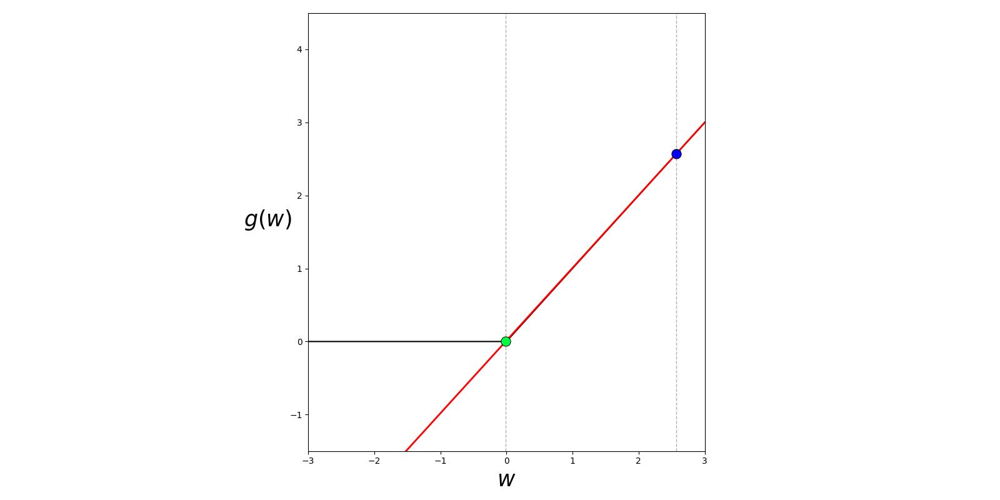
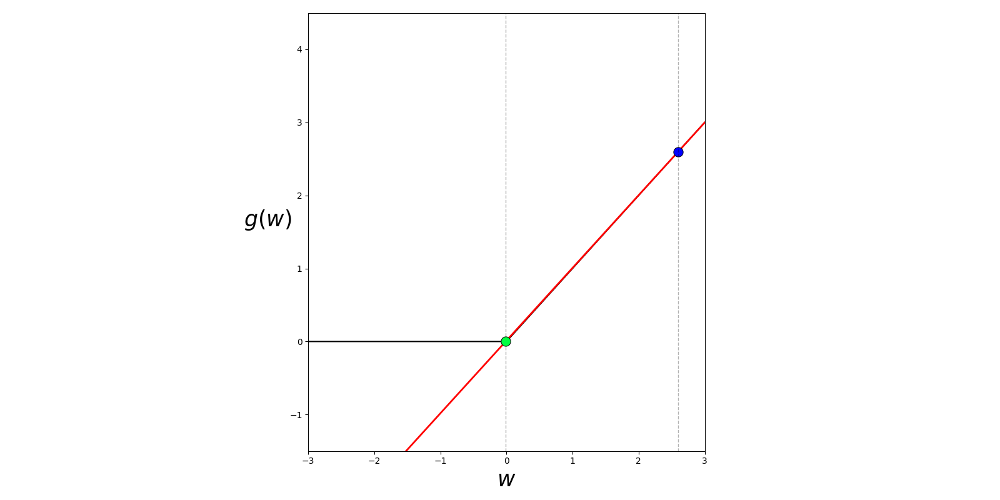

In [4]:
# what function should we play with?  Defined in the next line, along with our fixed point where we show tangency.
g = lambda w: np.maximum(w,0)

# create an instance of the visualizer with this function
st = calclib.secant_to_tangent.visualizer(g = g)

# run the visualizer for our chosen input function and initial point
st.draw_it(w_init = 0, num_frames = 200,mark_tangent = False)

## 1.3 From secant slope to derivative


- remember that the slope of a line measures its slope, or 'rise over run' 

\begin{equation}
\text{slope of secant line} = \frac{\text{change in $g$}}{\text{change in $w$}} = \frac{g(w^1) - g(w^0)}{w^1 - w^0}
\end{equation}

> The derivative of a function $g$ at a point $w^0$ is the slope of the tangent line there, which in turn is the slope of a secant line where $w^1$ is so close to $w^0$ that the both the change in $g$ and $w$ defining the slope of the tangent are infinitesimal small.

- e.g., $\epsilon = 0.0001$ then the point $w^1 = w^0 + \epsilon$ is quite close to $w^0$ to the right of $w_0$ and

\begin{equation}
\frac{g(w^1) - g(w^0)}{w^1 - w^0} = \frac{g(w^0 + \epsilon) - g(w^0)}{w^0 + \epsilon - w^0}
 =  \frac{g(w^0 + \epsilon) - g(w^0)}{\epsilon}
\end{equation}

- slope of secant from the left take point $w^1 = w^0 - \epsilon$ 

\begin{equation}
\frac{g(w^1) - g(w^0)}{w^1 - w^0} = \frac{g(w^0 - \epsilon) - g(w^0)}{w^0 - \epsilon - w^0}
 =  \frac{g(w^0 - \epsilon) - g(w^0)}{\epsilon}
\end{equation}

So if two secant line slopes the same

\begin{equation}
 \frac{g(w^0 + \epsilon) - g(w^0)}{\epsilon} \approx  - \frac{g(w^0 - \epsilon) - g(w^0)}{\epsilon}
\end{equation}

the give approximate derivative of $g$ at $w_0$.

- If derivative exists then as we make $\epsilon$ smaller and smaller these two quantities should *both* settle down to one value, and be *perfectly equal* to each other.  

- Writing this algebraically we say that we want the value $ \frac{g(w^0 + \epsilon) - g(w^0)}{\epsilon} $ to converge to a single value as  $\vert\epsilon\vert \longrightarrow 0$.

### Common notations for the derivative

\begin{equation}
\text{derivative} = \frac{\text{infinitesimal change in $g$}}{\text{infinitesimal change in $w$}}:= \frac{\mathrm{d}g}{\mathrm{d}w} \,\,\, \text{or} \,\,\, \frac{\mathrm{d}}{\mathrm{d}w}g
\end{equation}

To denote the derivative at a specific point $w^0$ we will write

\begin{equation}
\frac{\mathrm{d}}{\mathrm{d}w}g(w^0)
\end{equation}

#### <span style="color:#a50e3e;">Example 4. </span> Computing approximate derivatives at a point

- compute approximate derivative of sine at point $w^0 = 0$, and a small magnitude value for $\epsilon$ like $\epsilon = 0.0001$.  

- computing slope of secant line from both sides

\begin{equation}
\frac{g(w_0 + \epsilon) - g(w_0)}{\epsilon} = \frac{\text{sin}(0.0001)}{0.0001}\approx 0.99999
\end{equation}

and

\begin{equation}
-\frac{g(w^0 - \epsilon) - g(w^0)}{\epsilon} = -\frac{\text{sin}(-0.0001)}{0.0001}\approx 0.99999
\end{equation}

- both slopes are approximately equal, so we can definitively say at $w^0 = 0$ 

\begin{equation} 
\frac{\mathrm{d}}{\mathrm{d}w}g(w^0) \approx 0.99999 
\end{equation}

- equation of the tangent line to the sinusoid at $w^0 = 0$ is then 

\begin{equation}
h(w) = \text{sin}(0) + 0.9999(w - 0) = 0.9999w
\end{equation}

#### <span style="color:#a50e3e;">Example 5. </span> Checking non-differentiability at $w = 0$ for the relu function

- we saw how $ g(w) =  \text{max}(0,w) $ not differentiable at $w_0 = 0$ (at its kink)

- coming from the right

\begin{equation}
\frac{g(w^0 + \epsilon) - g(w^0)}{\epsilon} = \frac{\text{max}(0,0.0001)}{0.0001}= \frac{0.0001}{0.0001} = 1
\end{equation}

- coming from the left gives

\begin{equation}
-\frac{g(w^0 - \epsilon) - g(w^0)}{\epsilon} = -\frac{\text{max}(0,-0.0001)}{0.0001}= -\frac{0}{0.0001} = 0
\end{equation}

# 2. Our first derivative calculator: the Numerical Differentiation

## 2.1  Just use the definition

- most straightforward way to build a derivative calculator is to just use the definition of the derivative at a point

\begin{equation}
 \frac{\mathrm{d}}{\mathrm{d}w}g(w) \approx \frac{ g(w + \epsilon) - g(w)}{\epsilon} 
\end{equation}

- easy to implement in Python 


- a good introduction to Python classes, in particular for implementing mathematical functions and objects, can see e.g., [this excellent book](http://hplgit.github.io/primer.html/doc/pub/class/class-readable.html)

```
class numerical_derivative:
    '''
    A function for computing the numerical derivative
    of an arbitrary input function and user-chosen epsilon
    '''
    def __init__(self, g):
        # load in function to differentiate
        self.g = g; self.epsilon = 10*-5

    def __call__(self, w,**kwargs):
        # make local copies 
        g, epsilon = self.g, self.epsilon 
        
        # set epsilon to desired value or use default
        if 'epsilon' in kwargs:
            epsilon = kwargs['epsilon']
        
        # compute derivative approximation and return
        approx = (g(w+epsilon) - g(w))/epsilon
        return approx
```

In [5]:
class numerical_derivative:
    '''
    A function for computing the numerical derivative
    of an arbitrary input function and user-chosen epsilon
    '''
    def __init__(self, g):
        # load in function to differentiate
        self.g = g; self.epsilon = 10*-5

    def __call__(self, w,**kwargs):
        # make local copies 
        g, epsilon = self.g, self.epsilon 
        
        # set epsilon to desired value or use default
        if 'epsilon' in kwargs:
            epsilon = kwargs['epsilon']
        
        # compute derivative approximation and return
        approx = (g(w+epsilon) - g(w))/epsilon
        return approx

#### <span style="color:#a50e3e;">Example 6. </span>  A simple sinusoid

- this numerical differentiator computes accurate derivatives for a simple function like

\begin{equation}
g(w) = \text{sin}(w)
\end{equation}

 using $\epsilon = 10^{-2}$.

<IPython.core.display.Javascript object>


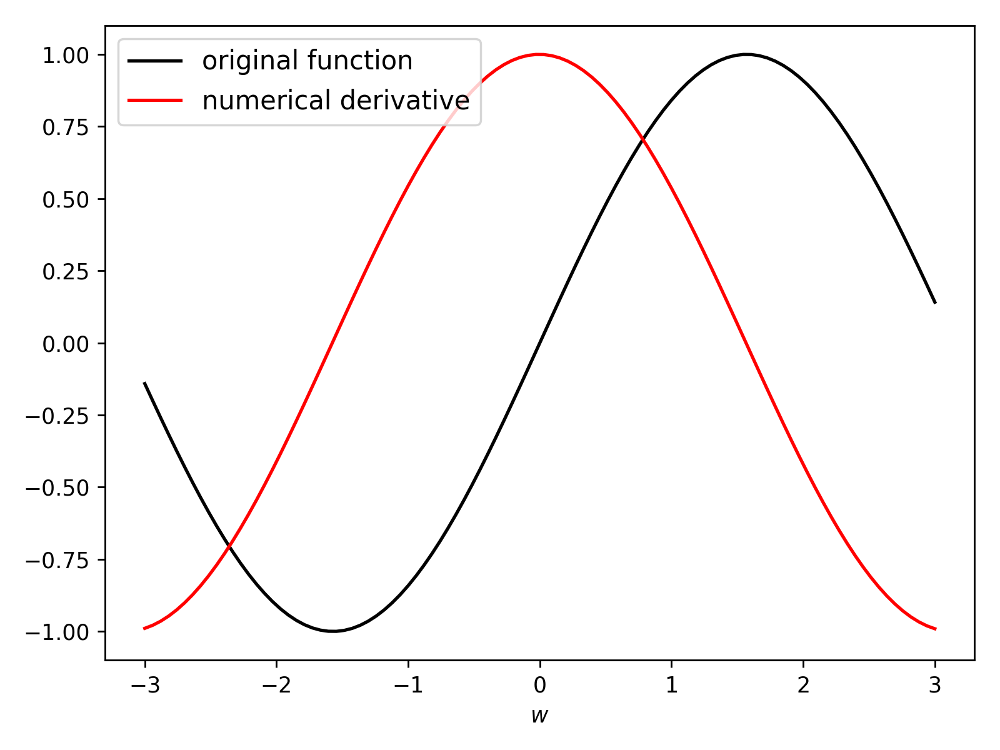

In [6]:
# make function, create derivative
g = lambda w: np.sin(w)
der = numerical_derivative(g)

# evaluate the derivative over this range of input
wvals = np.linspace(-3,3,100)
gvals = [g(w) for w in wvals]
dervals = [der(w,epsilon = 10**-2) for w in wvals]

# plot function and derivative
plt.plot(wvals,gvals,color = 'k',label = 'original function')
plt.plot(wvals,dervals,color = 'r',label = 'numerical derivative') 
plt.legend(bbox_to_anchor=(0, 1), loc=2,fontsize = 12); plt.xlabel('$w$')
plt.show()

- before we use $\epsilon = 10^{-2}$, but what value of $\epsilon$ should we use in general?

- in theory: the smaller the better

- in practice: if too small = computational errors due to finite precision of computer

- this is the problem with the numerical differentiator - too large and we do not approximate the derivative, too small we run into numerical errors

- for example, with the widget below we plot a large range of $\epsilon$ values


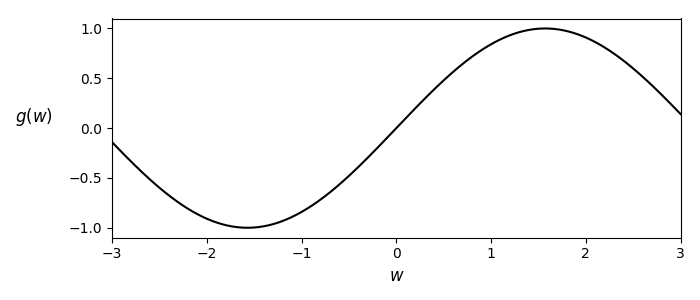
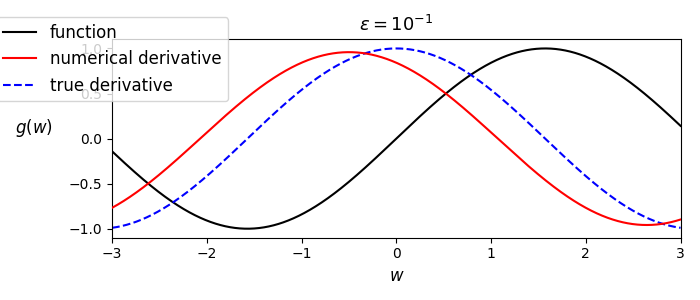
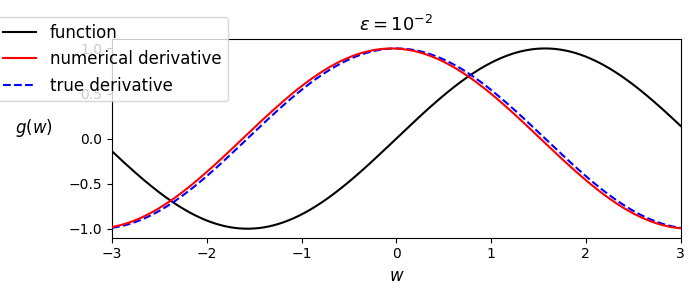
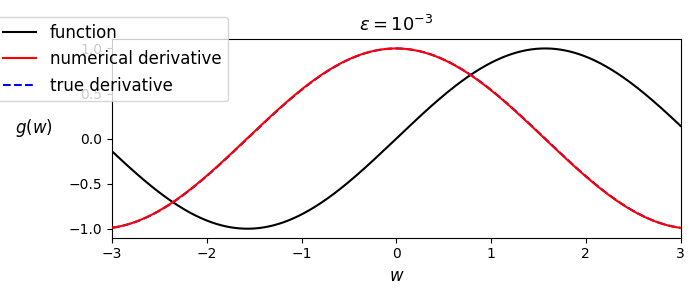
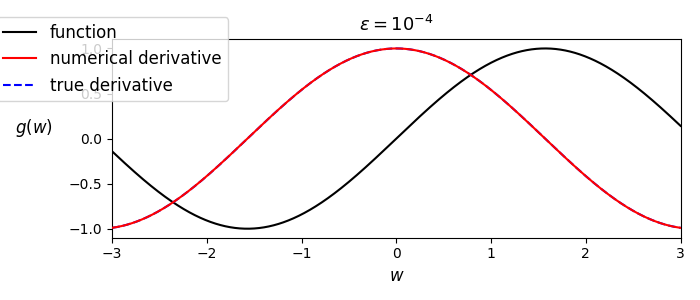
...
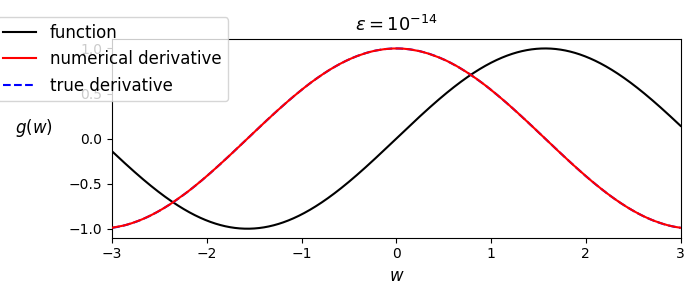
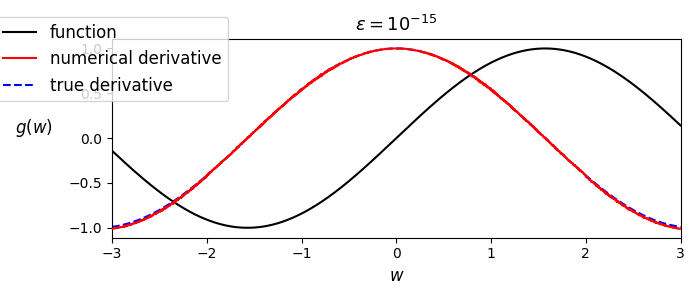
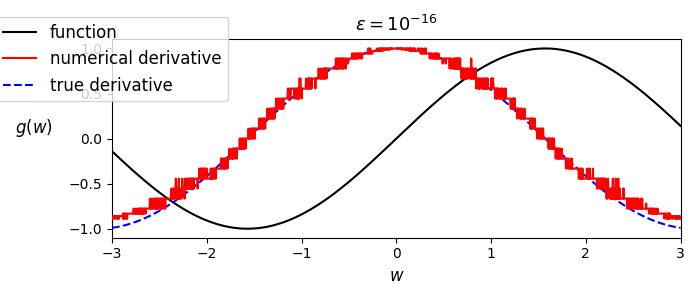
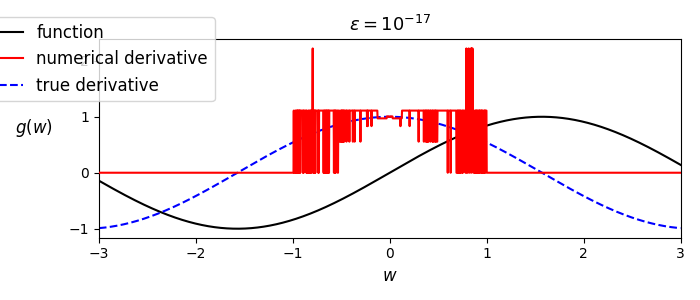
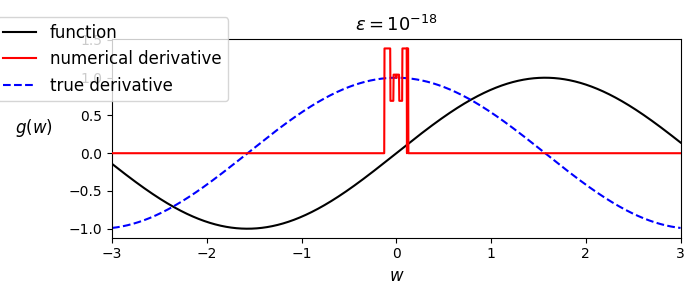

In [7]:
# what function should we play with?  Defined in the next line, along with our fixed point where we show tangency.
g = lambda w: np.sin(w)

# create an instance of the visualizer with this function
st = calclib.numder_silder.visualizer(g = g)

# run the visualizer for our chosen input function and initial point
st.draw_it()

- by around $\epsilon = 10^{-3}$ the numerical approximation of the derivative is virtually perfect


- when $\epsilon = 10^{-16}$ and smaller things start to fail 


- not so easy to choose for all functions - the curvier parts of a function need smaller $\epsilon$

### Where do numerical errors come from here?

- fractions close to $\frac{0}{0}$ difficult for computer to handle 

- hence $\frac{ g(w + \epsilon) - g(w)}{\epsilon}$ difficult for computer when $\epsilon \approx 0$

#### <span style="color:#a50e3e;">Example 7. </span> A rapidly changing approximation to the derivative 

Take another example  

$$
g(w) = \frac{\text{cos}(40w)^{100}}{w^2 + 1}
$$

- here we need to set $\epsilon$ considerably smaller - to around $10^{-6}$ - in order for the numerical derivative to approximate the true derivative well


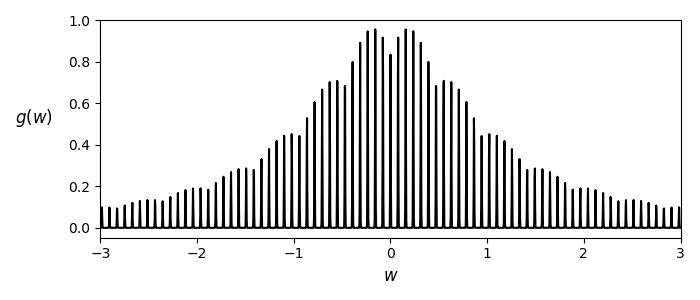
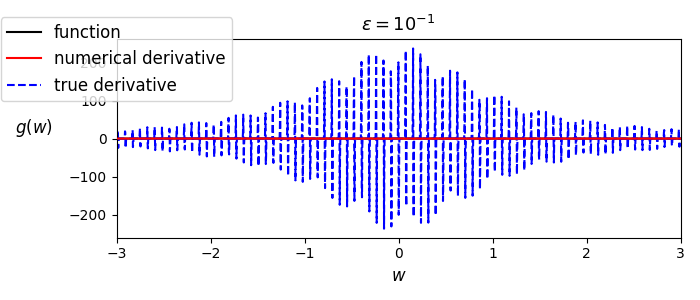
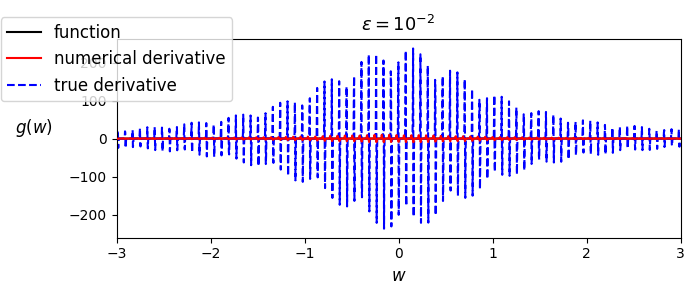
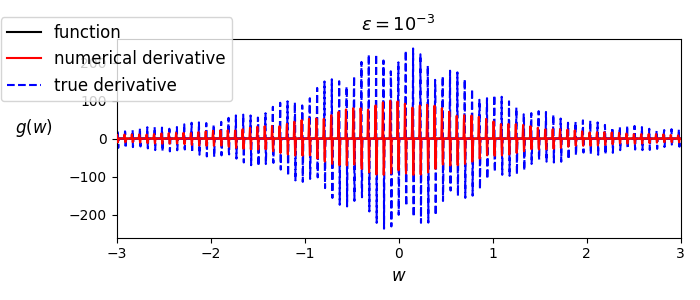
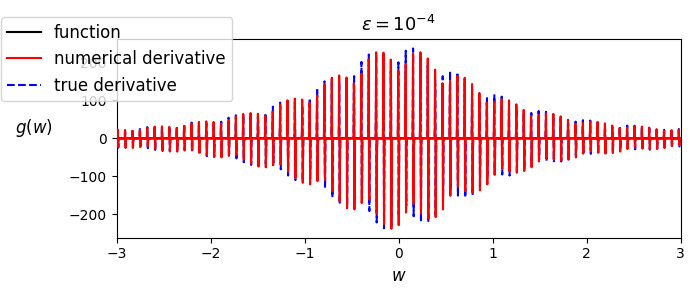
...
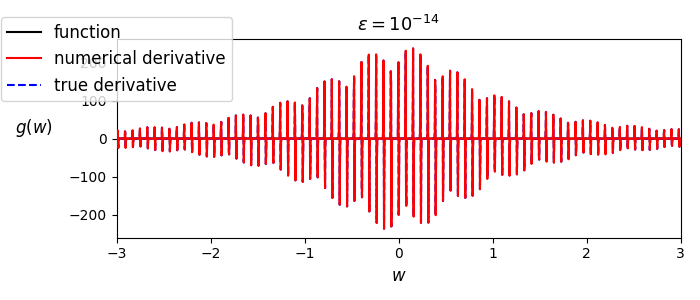
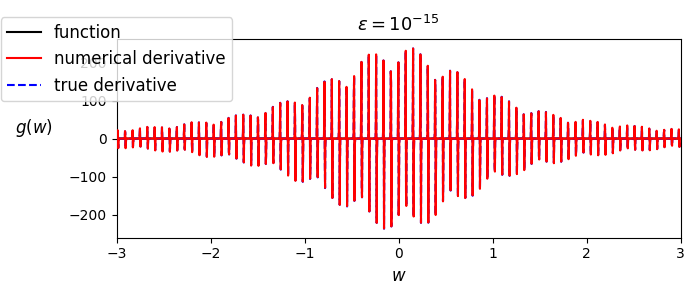
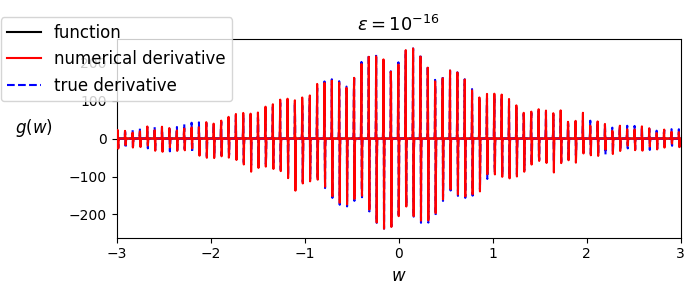
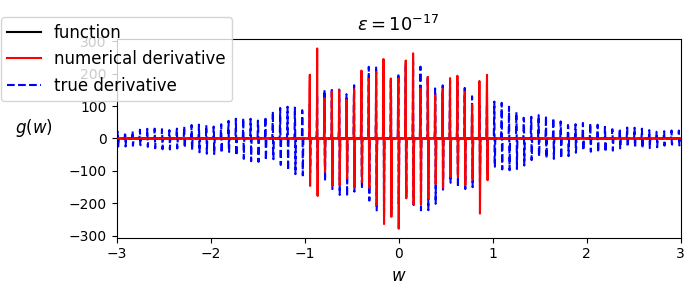
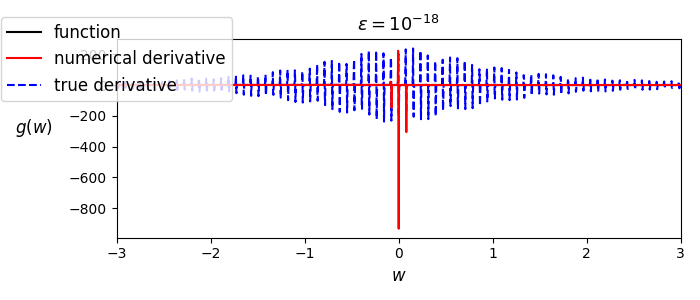

In [8]:
# what function should we play with?  Defined in the next line, along with our fixed point where we show tangency.
g = lambda w: np.cos(40*w)**100/(w**2 + 1)

# create an instance of the visualizer with this function
st = calclib.numder_silder.visualizer(g = g)

# run the visualizer for our chosen input function and initial point
st.draw_it()